In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import folium
from folium.plugins import HeatMap
import seaborn as sns
from collections import Counter
import calendar
import plotly.express as px
import plotly.io as pio
from branca.colormap import linear

In [8]:
df = pd.read_csv("C:/Users/Lenovo/Desktop/CBL/4CBLW00-20-MD-CBL/london_data.csv")
df_burglary = df[df['Crime type'] == 'Burglary']

geometry = [Point(xy) for xy in zip(df_burglary['Longitude'], df_burglary['Latitude'])]
gdf = gpd.GeoDataFrame(df_burglary, geometry=geometry)
wards = gpd.read_file("C:/Users/Lenovo/Downloads/statistical-gis-boundaries-london/ESRI/London_Ward_CityMerged.shp")

In [9]:
def resolve_duplicate_names(df):
    unresolved_names = []
    df = df.copy()  # avoid modifying original DataFrame

    # Group by NAME
    name_groups = df.groupby('NAME')

    for name, group in name_groups:
        if len(group) == 1:
            continue  # Unique, do nothing
        boroughs = group['BOROUGH'].unique()
        
        if len(boroughs) == len(group):  # All boroughs are different
            # Update NAME for each row in group
            for idx, row in group.iterrows():
                borough_first_word = row['BOROUGH'].split()[0]
                new_name = f"{row['NAME']}_{borough_first_word}"
                df.at[idx, 'NAME'] = new_name
        else:
            unresolved_names.append(name)

    return df, unresolved_names

wards_updated, duplicate_name_list = resolve_duplicate_names(wards)

In [10]:
gdf.set_crs(epsg=4326, inplace=True)
wards_updated = wards_updated.to_crs(epsg=4326)

print(wards_updated.crs)

EPSG:4326


In [93]:
if 'index_right' in gdf.columns:
    gdf = gdf.drop(columns='index_right')


gdf = gpd.sjoin(gdf, wards_updated, how='left', predicate='within')


In [94]:
gdf.head()

,Month,Falls within/Reported by,Longitude,Latitude,Location,LSOA code,Crime type,geometry,NAME_left,GSS_CODE_left,...,BOROUGH_right,POLY_ID_right,index_right,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID
28,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,...,Brent,50490.0,177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
29,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,...,Brent,50490.0,177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
30,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,...,Brent,50490.0,177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
31,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,...,Brent,50490.0,177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
39,2010-12,British Transport Police,0.021377,51.4138,On or near Sundridge Park,E01000823,Burglary,POINT (0.02138 51.4138),Plaistow and Sundridge,E05000125,...,Bromley,51336.0,56.0,Plaistow and Sundridge,E05000125,400.094,0.0,E09000006,Bromley,51336.0


In [95]:
def bbox_size(group):
    lat_range = group['Latitude'].max() - group['Latitude'].min()
    lon_range = group['Longitude'].max() - group['Longitude'].min()
    return (lat_range**2 + lon_range**2)**0.5 * 111_000  # degrees → meters

ward_spread = gdf.groupby('NAME').apply(bbox_size).reset_index(name='Approx_Spread_m')
ward_spread_sorted = ward_spread.sort_values(by='Approx_Spread_m', ascending=False)

# Look at top suspicious ones
print(ward_spread_sorted.head(10))


                             NAME  Approx_Spread_m
157                        Darwin     12079.489232
562                     Upminster     11551.044050
281             Heathrow Villages     11536.897423
100                         Chase     10982.569593
288                   High Barnet      8905.266513
125                   Cockfosters      8561.838459
551                    Totteridge      8292.267653
104  Chelsfield and Pratts Bottom      8178.853590
145              Cray Valley East      8061.412919
263                     Harefield      7962.959638


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_20908\487035419.py:6: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [96]:
col = gdf[gdf['NAME'] == 'Village_Merton']
col

,Month,Falls within/Reported by,Longitude,Latitude,Location,LSOA code,Crime type,geometry,NAME_left,GSS_CODE_left,...,BOROUGH_right,POLY_ID_right,index_right,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID
68405,2010-12,Metropolitan Police Service,-0.236540,51.418773,On or near Thurstan Road,E01003462,Burglary,POINT (-0.23654 51.41877),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
68408,2010-12,Metropolitan Police Service,-0.216395,51.430851,On or near Burghley Road,E01003464,Burglary,POINT (-0.2164 51.43085),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
68609,2010-12,Metropolitan Police Service,-0.218325,51.425611,On or near Lancaster Place,E01003461,Burglary,POINT (-0.21832 51.42561),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
68610,2010-12,Metropolitan Police Service,-0.215083,51.424267,On or near Wimbledon Hill Road,E01003461,Burglary,POINT (-0.21508 51.42427),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
68611,2010-12,Metropolitan Police Service,-0.216088,51.422852,On or near Oldfield Road,E01003461,Burglary,POINT (-0.21609 51.42285),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26798312,2024-12,Metropolitan Police Service,-0.238200,51.417863,On or near Chambers Park Hill,E01003463,Burglary,POINT (-0.2382 51.41786),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
26798313,2024-12,Metropolitan Police Service,-0.237396,51.418193,On or near Crawford Mews,E01003463,Burglary,POINT (-0.2374 51.41819),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
26992096,2025-01,Metropolitan Police Service,-0.219543,51.426466,On or near Rushmere Place,E01003460,Burglary,POINT (-0.21954 51.42647),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0
26992097,2025-01,Metropolitan Police Service,-0.218413,51.425180,On or near Allington Close,E01003460,Burglary,POINT (-0.21841 51.42518),Village_Merton,E05000472,...,Merton,50778.0,406.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0


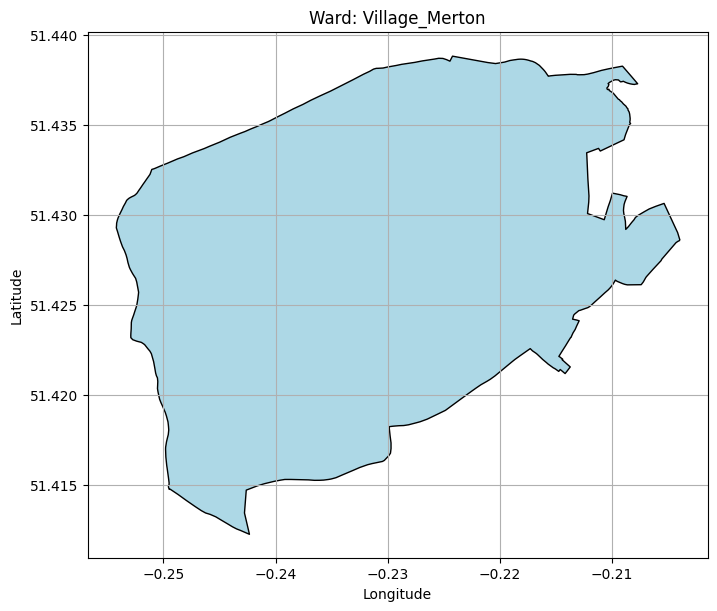

In [97]:
# Replace this with the ward name you want to see
ward_name = "Village_Merton"

# Filter the GeoDataFrame
selected_ward = wards_updated[wards_updated['NAME'] == ward_name]

# Plot it
ax = selected_ward.plot(edgecolor='black', facecolor='lightblue', figsize=(8, 8))
plt.title(f"Ward: {ward_name}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True)
plt.show()


In [101]:
cols_to_remove = ['Location', 'GSS_CODE', 'HECTARES', 'NONLD_AREA', 'LB_GSS_CD', 'BOROUGH', 'POLY_ID']

#gdf.drop(['Location', 'GSS_CODE', 'HECTARES', 'NONLD_AREA', 'LB_GSS_CD', 'BOROUGH', 'POLY_ID'], axis=1, inplace=True)
gdf.head()


,Month,Falls within/Reported by,Longitude,Latitude,LSOA code,Crime type,geometry,NAME_left,GSS_CODE_left,HECTARES_left,...,POLY_ID_left,NAME_right,GSS_CODE_right,HECTARES_right,NONLD_AREA_right,LB_GSS_CD_right,BOROUGH_right,POLY_ID_right,index_right,NAME
28,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,154.803,...,50490.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0,177.0,Willesden Green
29,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,154.803,...,50490.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0,177.0,Willesden Green
30,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,154.803,...,50490.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0,177.0,Willesden Green
31,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.22138 51.5492),Willesden Green,E05000105,154.803,...,50490.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0,177.0,Willesden Green
39,2010-12,British Transport Police,0.021377,51.4138,E01000823,Burglary,POINT (0.02138 51.4138),Plaistow and Sundridge,E05000125,400.094,...,51336.0,Plaistow and Sundridge,E05000125,400.094,0.0,E09000006,Bromley,51336.0,56.0,Plaistow and Sundridge


In [102]:
col = gdf[gdf['NAME'] == 'Village_Merton']
col.head()

,Month,Falls within/Reported by,Longitude,Latitude,LSOA code,Crime type,geometry,NAME_left,GSS_CODE_left,HECTARES_left,...,POLY_ID_left,NAME_right,GSS_CODE_right,HECTARES_right,NONLD_AREA_right,LB_GSS_CD_right,BOROUGH_right,POLY_ID_right,index_right,NAME
68405,2010-12,Metropolitan Police Service,-0.236540,51.418773,E01003462,Burglary,POINT (-0.23654 51.41877),Village_Merton,E05000472,621.285,...,50778.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0,406.0,Village_Merton
68408,2010-12,Metropolitan Police Service,-0.216395,51.430851,E01003464,Burglary,POINT (-0.2164 51.43085),Village_Merton,E05000472,621.285,...,50778.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0,406.0,Village_Merton
68609,2010-12,Metropolitan Police Service,-0.218325,51.425611,E01003461,Burglary,POINT (-0.21832 51.42561),Village_Merton,E05000472,621.285,...,50778.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0,406.0,Village_Merton
68610,2010-12,Metropolitan Police Service,-0.215083,51.424267,E01003461,Burglary,POINT (-0.21508 51.42427),Village_Merton,E05000472,621.285,...,50778.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0,406.0,Village_Merton
68611,2010-12,Metropolitan Police Service,-0.216088,51.422852,E01003461,Burglary,POINT (-0.21609 51.42285),Village_Merton,E05000472,621.285,...,50778.0,Village_Merton,E05000472,621.285,0.0,E09000024,Merton,50778.0,406.0,Village_Merton


In [ ]:
gdf.to_csv('london_crime_with_wards.csv', index=False)

In [2]:
wards_df = pd.read_csv("C:/Users/Lenovo/Desktop/CBL/4CBLW00-20-MD-CBL/london_crime_with_wards.csv")
wards_df.head()

,Month,Falls within/Reported by,Longitude,Latitude,Location,LSOA code,Crime type,geometry,index_right,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID
0,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
1,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
2,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
3,2010-12,British Transport Police,-0.221375,51.5492,On or near Willesden Green,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,E05000105,154.803,0.0,E09000005,Brent,50490.0
4,2010-12,British Transport Police,0.021377,51.4138,On or near Sundridge Park,E01000823,Burglary,POINT (0.021377 51.4138),56.0,Plaistow and Sundridge,E05000125,400.094,0.0,E09000006,Bromley,51336.0


In [3]:
def create_map (df):

    heat_data = df[['Latitude', 'Longitude']].dropna().values.tolist()

    map = folium.Map(location=[51.5072, -0.1276], zoom_start=10, tiles='cartodbpositron')

    HeatMap(
        data=heat_data,
        radius=1,         
        blur=2,          
        max_zoom=1        
    ).add_to(map)

    return map

In [4]:
map = create_map(wards_df)
map

In [11]:
column_name = 'NAME'
counts = wards_df[column_name].value_counts(dropna=False).to_dict()
wards_updated.head()

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry
0,Chessington South,E05000405,755.173,0.0,E09000021,Kingston upon Thames,50840,"POLYGON ((-0.33068 51.32901, -0.33059 51.32909..."
1,Tolworth and Hook Rise,E05000414,259.464,0.0,E09000021,Kingston upon Thames,117160,"POLYGON ((-0.30846 51.37586, -0.30834 51.37606..."
2,Berrylands,E05000401,145.390,0.0,E09000021,Kingston upon Thames,50449,"POLYGON ((-0.30385 51.39249, -0.30375 51.39252..."
3,Alexandra_Kingston,E05000400,268.506,0.0,E09000021,Kingston upon Thames,50456,"POLYGON ((-0.2699 51.38845, -0.26975 51.38838,..."
4,Beverley,E05000402,187.821,0.0,E09000021,Kingston upon Thames,117161,"POLYGON ((-0.24662 51.39921, -0.24672 51.39921..."


In [12]:
# Step 1: Count number of valid cases per ward (skip nulls)
ward_case_counts = wards_df['NAME'].dropna().value_counts().reset_index()
ward_case_counts.columns = ['NAME', 'no_cases']

# Step 2: Merge counts into wards_updated
wards_updated = wards_updated.merge(ward_case_counts, on='NAME', how='left')

# Step 3: Fill NaN with 0 (wards with no cases)
wards_updated['no_cases'] = wards_updated['no_cases'].fillna(0).astype(int)

In [13]:
# Define custom quantile bins
quantile_bins = [0, 0.2, 0.4, 0.6, 0.8, 0.9, 1.0]
quantile_labels = [f'P{i}' for i in range(6, 0, -1)]  # P11 = top 5%, ..., P1 = bottom 20%

# Apply qcut to assign quantiles
wards_updated['quantile'] = pd.qcut(
    wards_updated['no_cases'],
    q=quantile_bins,
    labels=quantile_labels
)

In [14]:
wards_updated.head()

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry,no_cases,quantile
0,Chessington South,E05000405,755.173,0.0,E09000021,Kingston upon Thames,50840,"POLYGON ((-0.33068 51.32901, -0.33059 51.32909...",667,P6
1,Tolworth and Hook Rise,E05000414,259.464,0.0,E09000021,Kingston upon Thames,117160,"POLYGON ((-0.30846 51.37586, -0.30834 51.37606...",952,P6
2,Berrylands,E05000401,145.390,0.0,E09000021,Kingston upon Thames,50449,"POLYGON ((-0.30385 51.39249, -0.30375 51.39252...",695,P6
3,Alexandra_Kingston,E05000400,268.506,0.0,E09000021,Kingston upon Thames,50456,"POLYGON ((-0.2699 51.38845, -0.26975 51.38838,...",752,P6
4,Beverley,E05000402,187.821,0.0,E09000021,Kingston upon Thames,117161,"POLYGON ((-0.24662 51.39921, -0.24672 51.39921...",1175,P6


In [ ]:
column_name = 'quantile'
counts = wards_updated[column_name].value_counts(dropna=False).to_dict()
counts

,NAME,GSS_CODE,HECTARES,NONLD_AREA,LB_GSS_CD,BOROUGH,POLY_ID,geometry,no_cases,quantile,quantile_num
0,Chessington South,E05000405,755.173,0.0,E09000021,Kingston upon Thames,50840,"POLYGON ((-0.33068 51.32901, -0.33059 51.32909...",667,P6,1
1,Tolworth and Hook Rise,E05000414,259.464,0.0,E09000021,Kingston upon Thames,117160,"POLYGON ((-0.30846 51.37586, -0.30834 51.37606...",952,P6,1
2,Berrylands,E05000401,145.390,0.0,E09000021,Kingston upon Thames,50449,"POLYGON ((-0.30385 51.39249, -0.30375 51.39252...",695,P6,1
3,Alexandra_Kingston,E05000400,268.506,0.0,E09000021,Kingston upon Thames,50456,"POLYGON ((-0.2699 51.38845, -0.26975 51.38838,...",752,P6,1
4,Beverley,E05000402,187.821,0.0,E09000021,Kingston upon Thames,117161,"POLYGON ((-0.24662 51.39921, -0.24672 51.39921...",1175,P6,1


In [16]:
quantile_labels = [f'P{i}' for i in range(6, 0, -1)]  # P11 = top 5%, ..., P1 = bottom 20%
quantile_to_number = {label: i for i, label in enumerate(quantile_labels, start=1)}
wards_updated['quantile_num'] = wards_updated['quantile'].map(quantile_to_number)

color_scale = linear.YlGnBu_09.scale(1, 6)
color_scale.caption = "Crime Density Quantiles by Ward"

# Create Folium map
m = folium.Map(location=[51.5072, -0.1276], zoom_start=10, tiles='cartodbpositron')

# Add polygons
for _, row in wards_updated.iterrows():
    if pd.notnull(row['quantile_num']):
        color = color_scale(row['quantile_num'])
    else:
        color = '#d3d3d3'  # light gray for missing
    folium.GeoJson(
        row['geometry'],
        style_function=lambda feature, color=color: {
            'fillColor': color,
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': 0.6,
        },
        tooltip=folium.Tooltip(f"{row['NAME']}: {row['quantile']}, {row['no_cases']} cases")
    ).add_to(m)

# Add color legend
color_scale.add_to(m)

m


In [17]:
columns_to_remove = [
    'Location',
    'GSS_CODE',
    'HECTARES',
    'NONLD_AREA',
    'LB_GSS_CD',
    'BOROUGH',
    'POLY_ID'
]
wards_df.drop(columns=columns_to_remove, inplace=True)

In [18]:
wards_df.head()

,Month,Falls within/Reported by,Longitude,Latitude,LSOA code,Crime type,geometry,index_right,NAME
0,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green
1,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green
2,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green
3,2010-12,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green
4,2010-12,British Transport Police,0.021377,51.4138,E01000823,Burglary,POINT (0.021377 51.4138),56.0,Plaistow and Sundridge


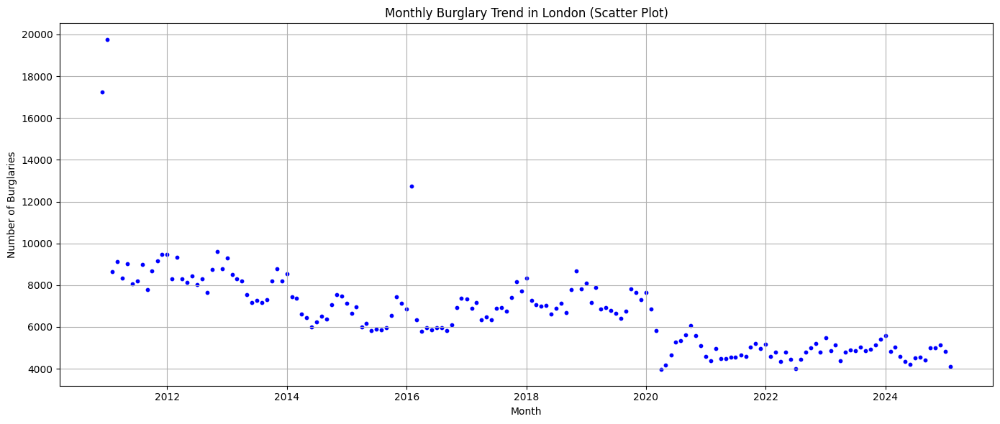

In [19]:
import matplotlib.pyplot as plt

# Ensure 'Month' is datetime
wards_df['Month'] = pd.to_datetime(wards_df['Month'], format='%Y-%m')

# Group by Month
monthly_trend = wards_df.groupby('Month').size().reset_index(name='burglary_count')

# Create scatter plot
plt.figure(figsize=(14, 6))
plt.scatter(monthly_trend['Month'], monthly_trend['burglary_count'], s=10, color='blue')  # s = point size

plt.title("Monthly Burglary Trend in London (Scatter Plot)")
plt.xlabel("Month")
plt.ylabel("Number of Burglaries")
plt.grid(True)
plt.tight_layout()
plt.show()



In [21]:
wards_df.head()

,Month,Falls within/Reported by,Longitude,Latitude,LSOA code,Crime type,geometry,index_right,NAME,year,month
0,2010-12-01,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,2010,12
1,2010-12-01,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,2010,12
2,2010-12-01,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,2010,12
3,2010-12-01,British Transport Police,-0.221375,51.5492,E01000642,Burglary,POINT (-0.221375 51.5492),177.0,Willesden Green,2010,12
4,2010-12-01,British Transport Police,0.021377,51.4138,E01000823,Burglary,POINT (0.021377 51.4138),56.0,Plaistow and Sundridge,2010,12


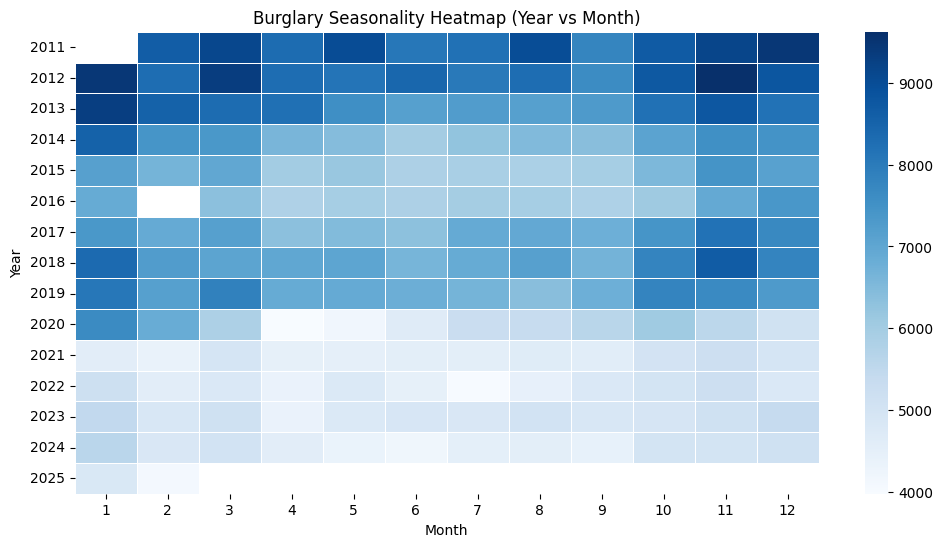

In [25]:
# Extract year and month
wards_df['year'] = wards_df['Month'].dt.year
wards_df['month'] = wards_df['Month'].dt.month

# Pivot table for heatmap
df3 = wards_df[~((wards_df['year']==2011) & (wards_df['month']==1))]
df3 = df3[~((df3['year']==2010) & (df3['month']==12))]
df3 = df3[~((df3['year']==2016) & (df3['month']==2))]
pivot = df3.groupby(['year', 'month']).size().unstack()

plt.figure(figsize=(12, 6))
sns.heatmap(pivot, cmap="Blues", linewidths=0.5, annot=False)
plt.title("Burglary Seasonality Heatmap (Year vs Month)")
plt.xlabel("Month")
plt.ylabel("Year")
plt.show()


In [116]:
col = wards_df[wards_df['Month'] == '2011-01']

In [117]:
len(col)

19747

In [118]:
# Use browser to render
pio.renderers.default = 'browser'

# Prepare data
wards_df['Month'] = pd.to_datetime(wards_df['Month'], format='%Y-%m')
monthly = wards_df.groupby('Month').size().reset_index(name='burglary_count')

# Make plot
fig = px.line(
    monthly,
    x='Month',
    y='burglary_count',
    title='Monthly Burglary Counts in London',
    labels={'Month': 'Date', 'burglary_count': 'Number of Burglaries'}
)

fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(count=2, label="2y", step="year", stepmode="backward"),
                dict(step="all", label="All")
            ])
        ),
        rangeslider=dict(visible=True),
        type="date"
    ),
    template="plotly_white"
)

fig.show()



In [30]:
monthly_counts = wards_df.groupby(['year', 'month']).size().reset_index(name='incident_count')

monthly_counts = monthly_counts.sort_values(['year', 'incident_count'], ascending=[True, False])

top5_dict = (
    monthly_counts
    .groupby('year')['month']
    .apply(lambda x: x.head(3).tolist())
    .to_dict()
)

keys_to_remove = [2010, 2025]

# Create a new dictionary without those keys
filtered_dict = {k: v for k, v in top5_dict.items() if k not in keys_to_remove}
top5_dict_named = {year: [calendar.month_name[m] for m in months] for year, months in filtered_dict.items()}

print(filtered_dict)


{2011: [1, 12, 11], 2012: [11, 1, 3], 2013: [1, 11, 2], 2014: [1, 11, 12], 2015: [11, 1, 12], 2016: [2, 12, 11], 2017: [11, 12, 10], 2018: [11, 1, 12], 2019: [1, 3, 10], 2020: [1, 2, 10], 2021: [11, 10, 12], 2022: [11, 1, 10], 2023: [1, 12, 11], 2024: [1, 12, 3]}


In [31]:
all_top_months = [month for months in top5_dict_named.values() for month in months]

month_counts = Counter(all_top_months)

month_counts = dict(sorted(month_counts.items(), key=lambda item: item[1], reverse=True))

print(month_counts)


{'January': 11, 'November': 11, 'December': 9, 'October': 5, 'March': 3, 'February': 3}


In [29]:
len(filtered_dict)

14